# VQA v2.0 Interactive Notebook - Faster R-CNN with Attention

## Import Libraries

In [1]:
# Import libraries
import importlib
import os
import string
from collections import Counter
from typing import Iterable, List

import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.nn.init as init
import torch.nn.utils.rnn as rnn_utils
import torch.optim as optim
import torchtext.data.utils as text_utils
import torchvision
from torch.utils.data import DataLoader
from torch.utils.data.sampler import SubsetRandomSampler
from torchtext.vocab import Vocab
from torchvision import transforms

In [2]:
# Check GPU
if not torch.cuda.is_available():
    raise RuntimeError('GPU with CUDA support is required')
device = torch.device('cuda')

In [3]:
# Import utils
if not os.path.exists('./utils'):
    !git clone https://github.com/heyuhang0/DL-BigProject-VQA.git
    !ln -s ./DL-BigProject-VQA/utils ./utils

if os.path.exists('./DL-BigProject-VQA/utils'):
    !cd ./DL-BigProject-VQA/utils && git pull

import utils.data as data_util
import utils.helper as helper
import utils.train as train_util

importlib.reload(data_util)
importlib.reload(helper)
importlib.reload(train_util)
pass

## Load Dataset

In [4]:
# Load dataset (single word answer only)
image_transform = transforms.Compose([
    transforms.Resize(int(224 / 0.875)),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
])

question_vocab = Vocab(Counter())
answer_vocab = Vocab(Counter(), specials=['no', 'yes'])


def tokenizer(question: str) -> List[str]:
    # to lower case
    question = question.lower()
    # remove punctuation
    trans = str.maketrans('', '', string.punctuation)
    question = question.translate(trans)
    # split words
    return question.split()


def question_transform(question: str):
    tokens = tokenizer(question)
    indices = [question_vocab[token] for token in tokens]
    return torch.tensor(indices, dtype=torch.long)


def question_transform_factory(corpus: Iterable[str]):
    global question_vocab
    counter = Counter()
    for text in corpus:
        counter.update(tokenizer(text))
    question_vocab = Vocab(counter, specials=['<pad>', '<unk>'])
    return question_transform


def answer_tansform(answer: str):
    return answer_vocab[answer]


def answer_tansform_factory(corpus: Iterable[str]):
    global answer_vocab
    answer_vocab = Vocab(Counter(corpus), specials=['<unk>'], min_freq=10)
    return answer_tansform


train_dataset = data_util.VQA2Dataset(
    './VQA2/', train=True,
    filter_func=data_util.yes_no_only_filter,
    image_transform=image_transform,
    question_transform_factory=question_transform_factory,
    answer_transform_factory=answer_tansform_factory,
    download=True)

valid_dataset = data_util.VQA2Dataset(
    './VQA2/', train=False,
    filter_func=data_util.yes_no_only_filter,
    image_transform=image_transform,
    question_transform=question_transform,
    answer_transform=answer_tansform)

print('train_dataset:', len(train_dataset))
print('valid_dataset:', len(valid_dataset))
print('quesiton_vocab size:', len(question_vocab))
print('answer_vocab size:  ', len(answer_vocab))

train_dataset: 167494
valid_dataset: 80810
quesiton_vocab size: 10745
answer_vocab size:   3


In [5]:
# Save vocab
import json

with open('./models/attention_faster_rcnn_yn_questions.json', 'w', encoding='utf-8') as fp:
    json.dump(question_vocab.freqs, fp)

with open('./models/attention_faster_rcnn_yn_answers.json', 'w', encoding='utf-8') as fp:
    json.dump(answer_vocab.freqs, fp)

## Create Dataloader

In [6]:
# Create dataloader
batch_size = 64
PAD_IDX = question_vocab['<pad>']


def generate_batch(data_batch):
    data_batch.sort(key=lambda x: -len(x[1]))  # for pack_padded_sequence
    images, questions, answers = zip(*data_batch)
    images = torch.stack(images, 0)
    q_lengths = [len(q) for q in questions]
    questions = rnn_utils.pad_sequence(questions, padding_value=PAD_IDX)
    answers = torch.tensor(answers, dtype=torch.long)
    return images, questions, q_lengths, answers


train_loader = DataLoader(
    train_dataset,
    batch_size=batch_size,
    collate_fn=generate_batch,
    shuffle=True)

valid_loader = DataLoader(
    valid_dataset,
    batch_size=batch_size,
    collate_fn=generate_batch,
    sampler=SubsetRandomSampler(list(range(512))))  # use a subset of the validation dataset

Q: are there more frisbees on the ground than in his hands
A: yes


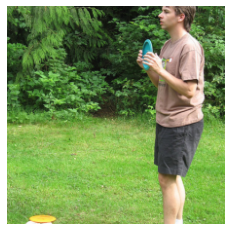

Q: is the person in the pink a woman
A: yes


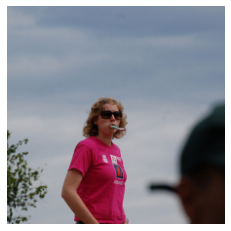

Q: are these boxes too heavy for one person
A: yes


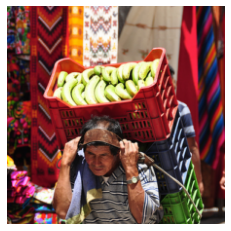

Q: is this photo taken into the united states
A: no


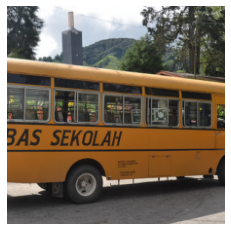

Q: are there any animals in the picture
A: no


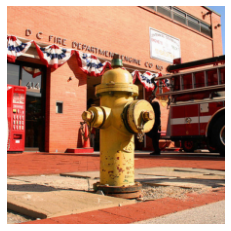

Q: does the kite have a blue tail
A: no


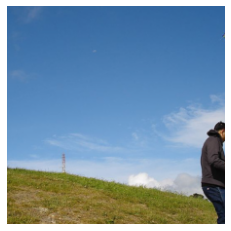

Q: can the couch also be a bed
A: no


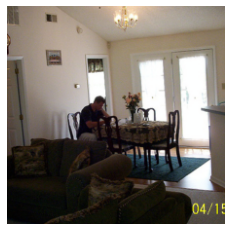

Q: are there seeds on the sandwich bun
A: yes


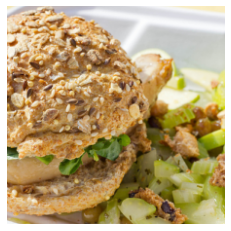

Q: is the dog wanting in the house
A: no


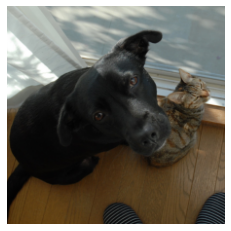

Q: is this picture taken during the afternoon
A: no


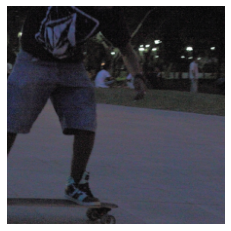

Q: does this bus cater to handicapped people
A: yes


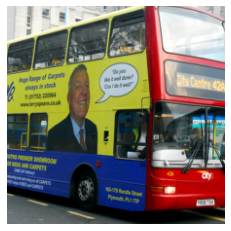

Q: was this picture taken from the air
A: no


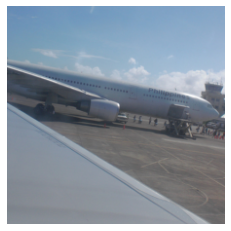

Q: are these people reflected in a mirror
A: no


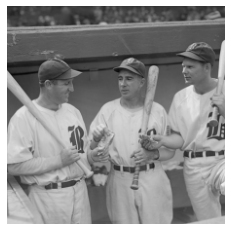

Q: is this clock suspended from the ceiling
A: yes


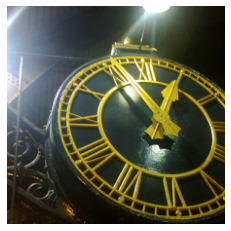

Q: are there any bananas in the picture
A: no


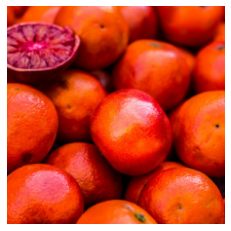

Q: can you see outside form this point
A: no


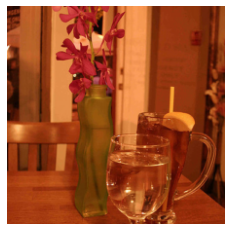

Q: are there any people in the picture
A: no


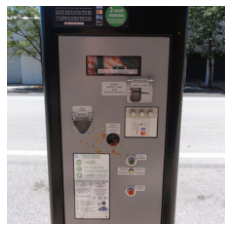

Q: does the bus have its headlights on
A: no


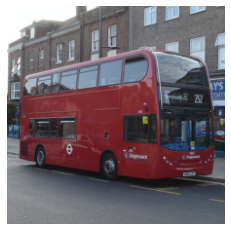

Q: do the animals need to be shaved
A: yes


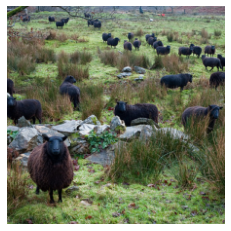

Q: are all the sheep on their feet
A: yes


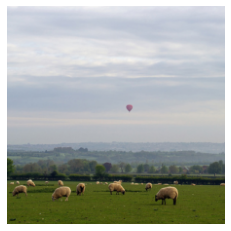

Q: is there blue paint on the tree
A: no


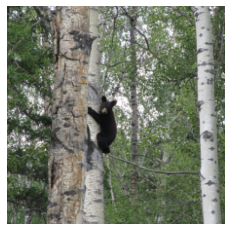

Q: does this day look bright and sunny
A: yes


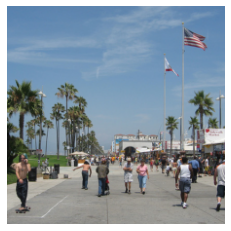

Q: was this picture taken in this decade
A: no


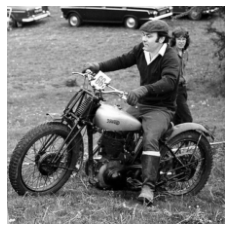

Q: is a foreign language on the train
A: no


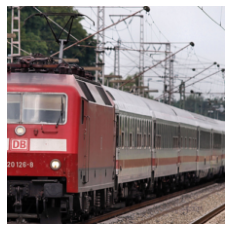

Q: does this person have short hair
A: no


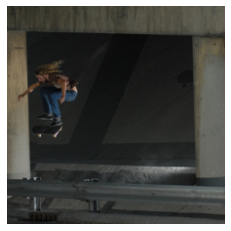

Q: is there snow in the background
A: no


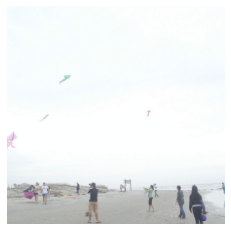

Q: is the clock number roman numeral
A: no


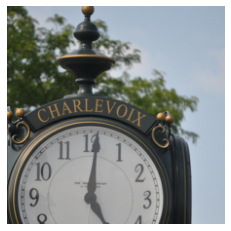

Q: are all of the people adults
A: no


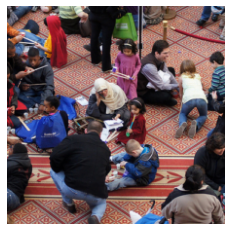

Q: is there snow on the ground
A: yes


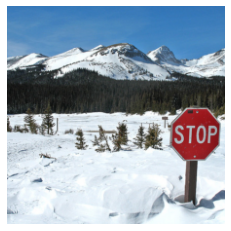

Q: is the computer playing a movie
A: yes


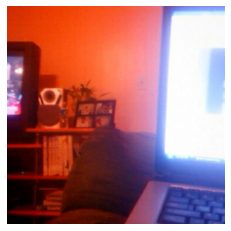

Q: is the man wearing a belt
A: no


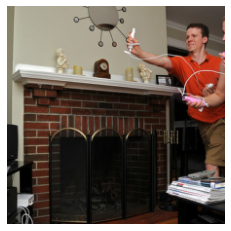

Q: are the trees covered with snow
A: yes


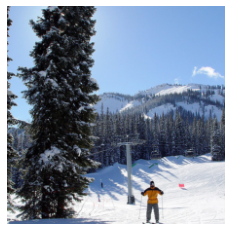

Q: are these buses off duty now
A: no


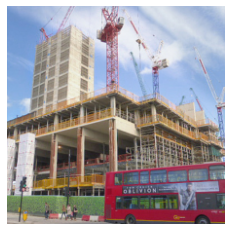

Q: is the plane in the air
A: yes


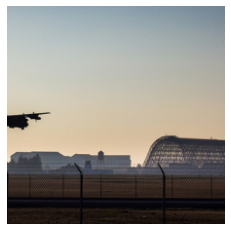

Q: is there straw in the barn
A: yes


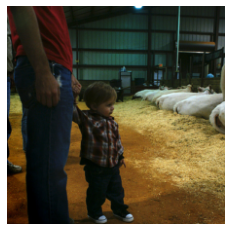

Q: is this a modern photo
A: yes


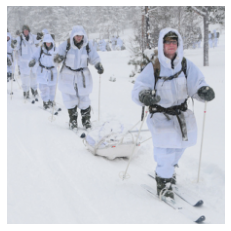

Q: is that a skillful move
A: yes


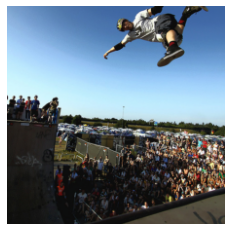

Q: is this in the forest
A: no


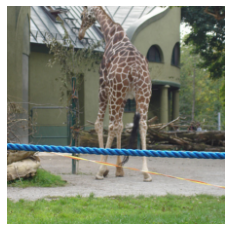

Q: do these flowers look healthy
A: no


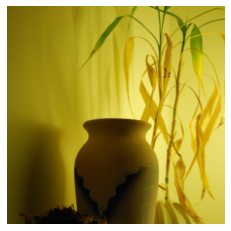

Q: is this a passenger plane
A: yes


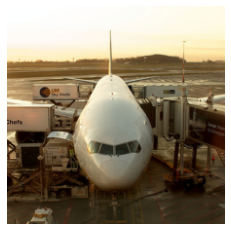

Q: are all the dishes white
A: yes


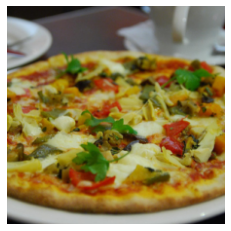

Q: is this a professional game
A: yes


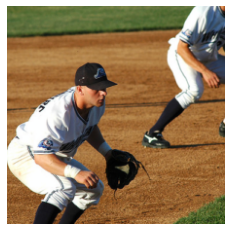

Q: is the man wearing glasses
A: yes


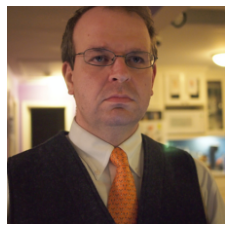

Q: is the toilet seat up
A: no


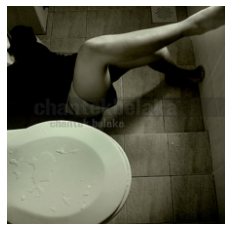

Q: are they on a beach
A: no


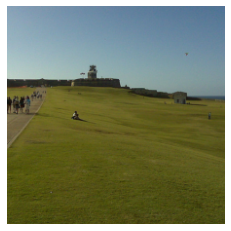

Q: is the computer monitor on
A: yes


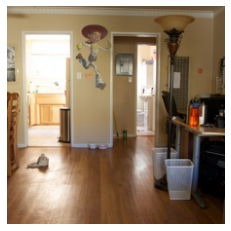

Q: is this an american town
A: yes


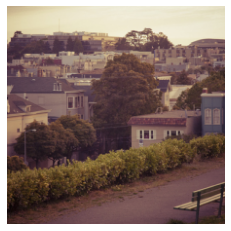

Q: is this a contest
A: no


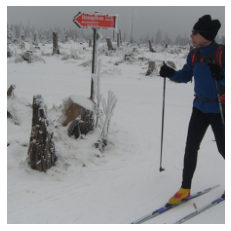

Q: is the person wet
A: yes


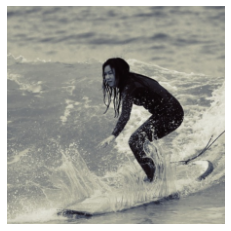

Q: is this a church
A: no


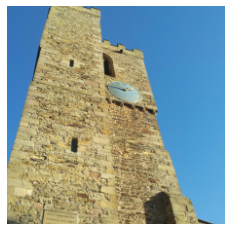

Q: is this a mountainside
A: yes


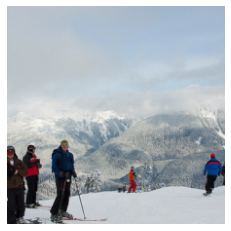

Q: are the horses drowning
A: no


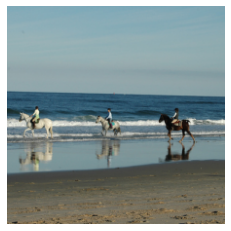

Q: is the woman happy
A: yes


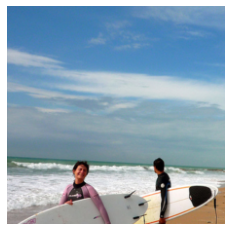

Q: are the birds black
A: no


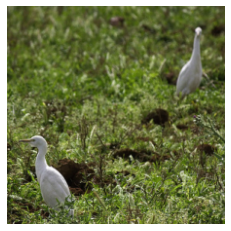

Q: are there any animals
A: no


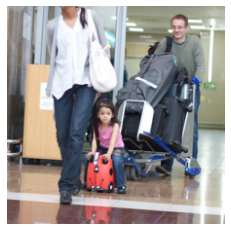

Q: is the area littered
A: yes


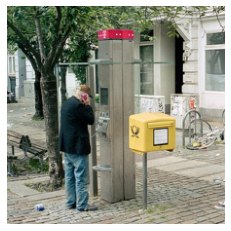

Q: is this lady skiing
A: yes


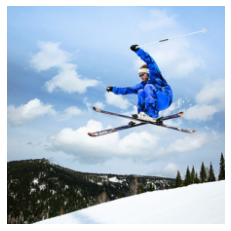

Q: is anyone wearing glasses
A: yes


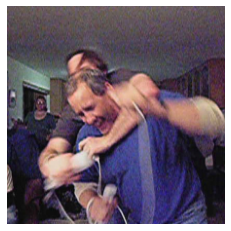

Q: is the cat angry
A: no


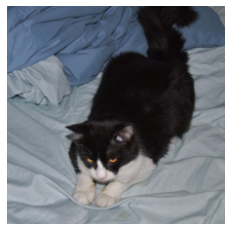

Q: is this a kitchen
A: no


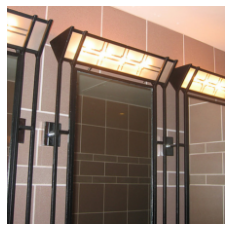

Q: are the bananas ripe
A: yes


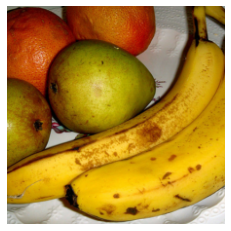

Q: is the entree cold
A: no


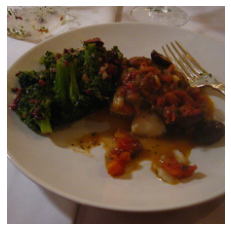

Q: is it cloudy
A: yes


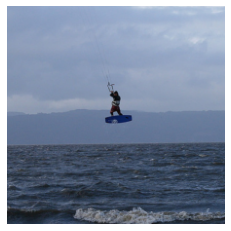

Q: is this healthy
A: no


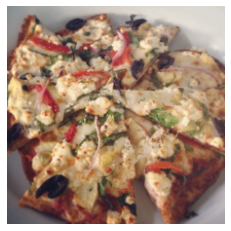

In [7]:
# Visualize some samples
def sequence_to_sentence(seq: List[int]) -> str:
    sentence = []
    for i in seq:
        if i == PAD_IDX:
            break
        sentence.append(question_vocab.itos[i])
    return ' '.join(sentence)


def visualize_samples(images, questions, answers, max_num=-1):
    if max_num < 0:
        max_num = len(images)

    # PyTorch RNN is using (seq_len, batch, input_size)
    # make it (batch, seq_len, input_size)
    questions = questions.transpose(0, 1)

    for _, v, q, a in zip(range(max_num), images, questions, answers):
        print('Q:', sequence_to_sentence(q))
        print('A:', answer_vocab.itos[a])
        helper.imshow(v)
        plt.show()


images, questions, _, answers = next(iter(train_loader))
visualize_samples(images, questions, answers)

## Create Model

In [8]:
class VNet(nn.Module):
    def __init__(self, pretrained=True):
        super().__init__()
        self.backbone = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=pretrained).backbone
        self.out_channels = self.backbone.out_channels
    
    def forward(self, images):
        return self.backbone(images)['3']

In [9]:
class QNet(nn.Module):
    def __init__(self, vocab, embedding_dim, out_dim, weights_path=None):
        super().__init__()
        self.embedding = nn.Embedding(len(vocab), embedding_dim)
        self.tanh = nn.Tanh()
        self.rnn = nn.LSTM(embedding_dim, out_dim)

        if weights_path:
            counter = 0
            weights = self.embedding.weight.detach().numpy()
            with open(weights_path, encoding='utf-8') as f:
                for line in f:
                    elements = line.split(' ')

                    word = elements[0]
                    if word not in question_vocab.stoi:
                        continue

                    embed = np.asarray(elements[1:], dtype='float32')
                    weights[question_vocab.stoi[word]] = embed

                    counter += 1
                    if counter / len(question_vocab) > 0.9:
                        break
            self.embedding.weight.data.copy_(torch.from_numpy(weights))


    def forward(self, q, q_len):
        embedded = self.embedding(q)
        tanhed = self.tanh(embedded)
        packed = rnn_utils.pack_padded_sequence(tanhed, q_len)
        _, (_, features) = self.rnn(packed)
        features = features.squeeze(0)
        return features


In [10]:
class VQANet(nn.Module):
    def __init__(self, vocab, num_classes: int):
        super().__init__()
        self.v_net = VNet()
        self.q_net = QNet(vocab, 100, 256, './models/glove.6B.100d.txt')

        self.v_query = nn.Sequential(
            nn.Conv2d(256, 128, 1),
            nn.Sigmoid())
        self.q_query = nn.Sequential(
            nn.Linear(256, 128),
            nn.Sigmoid())
        self.attention_softmax = nn.Softmax(dim=1)

        self.q_fc = nn.Sequential(
            nn.Linear(256, 256),
            nn.Sigmoid())

        self.classifier = nn.Sequential(
            nn.Linear(256, 512),
            nn.ReLU(True),
            nn.Linear(512, num_classes))
        self.last_attention = None

    def forward(self, v, q, q_len):
        v_feat = self.v_net(v)
        q_feat = self.q_net(q, q_len)

        v_query = self.v_query(v_feat)
        q_query = self.q_query(q_feat)
        attention = (v_query * q_query.view((-1, 128, 1, 1))).sum(dim=1)
        attention = self.attention_softmax(attention.view(-1, 7*7)).view(-1, 1, 7, 7)
        self.last_attention = attention.detach()  # save for visualization

        v_final = (v_feat * attention).view((-1, 256, 7*7)).sum(dim=2)
        q_final = self.q_fc(q_feat)
        out = self.classifier(v_final * q_final)
        return out

In [11]:
model = VQANet(question_vocab, len(answer_vocab)).to(device)
for p in model.v_net.parameters():
    p.requires_grad = False

## Load Pretrained Weights

In [12]:
model = train_util.load_model(model, './models/attention_faster_rcnn_yn_weights.pth')

## Train Model

In [ ]:
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters())

history = train_util.train_model(
    model, criterion, optimizer,
    train_loader,
    valid_loader,
    epochs=10,
    valid_every=200)
train_util.plot_history(history)

Epoch: 1/10 @ 2021-05-01 12:51:07.035816
2618/2618 [==============================] - 3133s 1197ms/step - loss: 0.682 - accuracy: 0.551 - val_loss: 0.676 - val_accuracy: 0.572 - saved to checkpoints/2021-05-01_12-51/ckpt_00.pth
Epoch: 2/10 @ 2021-05-01 13:43:19.653268
2618/2618 [==============================] - 3174s 1212ms/step - loss: 0.675 - accuracy: 0.569 - val_loss: 0.672 - val_accuracy: 0.562 - saved to checkpoints/2021-05-01_12-51/ckpt_01.pth
Epoch: 3/10 @ 2021-05-01 14:36:13.786271
2618/2618 [==============================] - 3158s 1206ms/step - loss: 0.663 - accuracy: 0.585 - val_loss: 0.661 - val_accuracy: 0.594 - saved to checkpoints/2021-05-01_12-51/ckpt_02.pth
Epoch: 4/10 @ 2021-05-01 15:28:51.650312
2618/2618 [==============================] - 3127s 1194ms/step - loss: 0.648 - accuracy: 0.611 - val_loss: 0.662 - val_accuracy: 0.598 - saved to checkpoints/2021-05-01_12-51/ckpt_03.pth
Epoch: 5/10 @ 2021-05-01 16:20:58.469251
2618/2618 [==============================] - 30

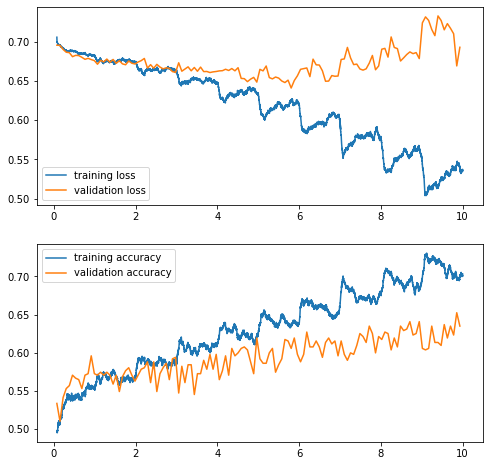

In [19]:
train_util.plot_history(history)

## Test Model

In [13]:
# Accuracy on the validation set
valid_loss, valid_accu = train_util.validate_model(model, valid_loader, nn.CrossEntropyLoss())
print('loss:', valid_loss)
print('accu:', valid_accu)

loss: 0.6937044858932495
accu: 0.63671875


Q: is it possible to assess the wind current direction by looking at the colored items
A: yes
Model: yes


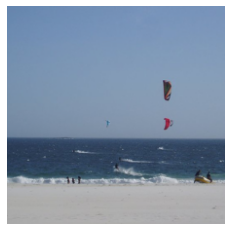

Q: are all of the people in the middle of the image children
A: no
Model: no


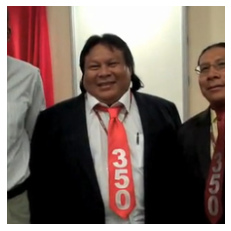

Q: is the cat taller than the height of one shelf
A: yes
Model: no


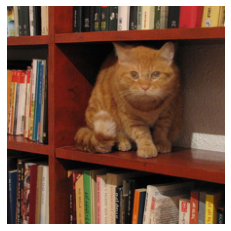

Q: is the person in the green vest a cop
A: no
Model: no


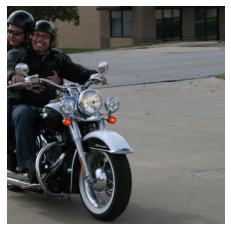

Q: is there a round vegetable that matches this sweater
A: yes
Model: yes


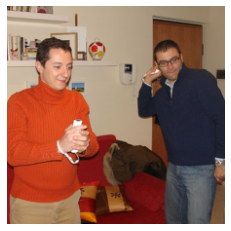

Q: would you be comfortable using this with a buddy
A: no
Model: no


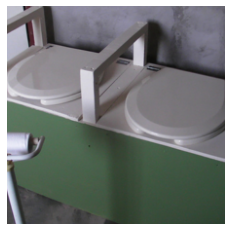

Q: have you tried a hot dog like this before
A: yes
Model: yes


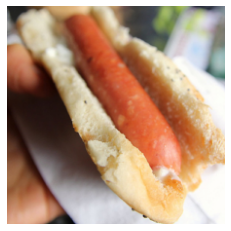

Q: is the knife by the cake a bread knife
A: yes
Model: yes


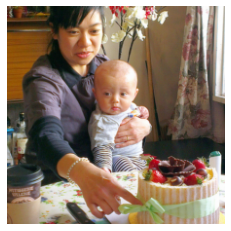

Q: can you read what the bus sign says
A: no
Model: no


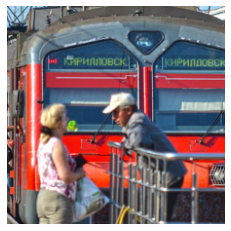

Q: is the water on top of the man
A: no
Model: no


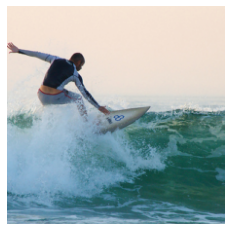

Q: does her surfboard have a motor on it
A: no
Model: no


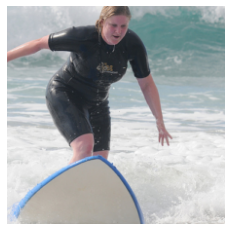

Q: is this what goes in a suitcase
A: no
Model: no


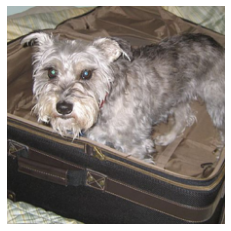

Q: is there a reflection in the scene
A: yes
Model: yes


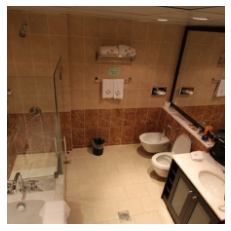

Q: does this pizza have pineapple on it
A: no
Model: no


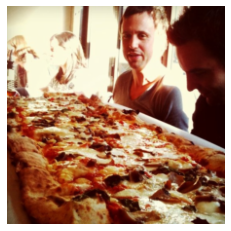

Q: is the motorcycle with lighter rims ahead
A: yes
Model: yes


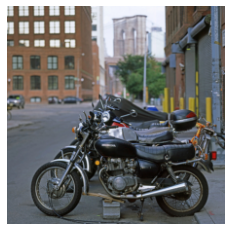

Q: are there stickers on the laptop
A: yes
Model: no


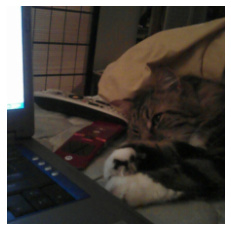

Q: is the man running wearing sunglasses
A: yes
Model: yes


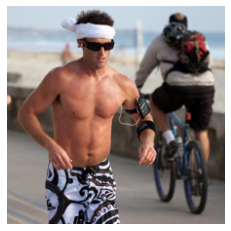

Q: are there clouds that are visible
A: yes
Model: yes


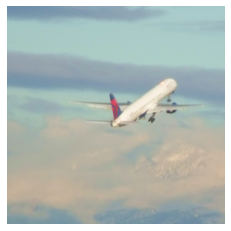

Q: is it dark in the photo
A: no
Model: yes


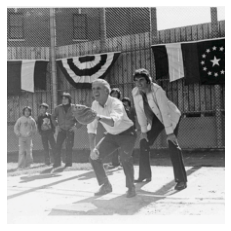

Q: are they playing on the grass
A: yes
Model: yes


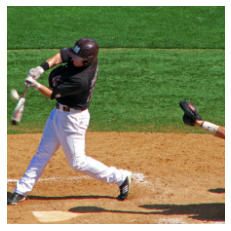

Q: is there meat on this plate
A: yes
Model: yes


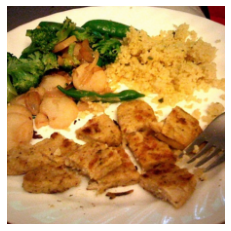

Q: do the people watching look excited
A: no
Model: no


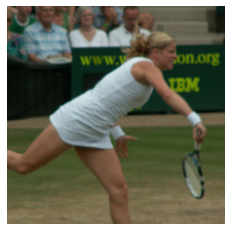

Q: can you see a white balloon
A: yes
Model: yes


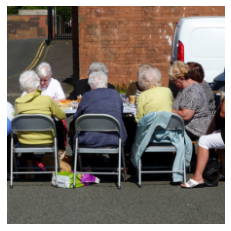

Q: is the ball on the ground
A: no
Model: no


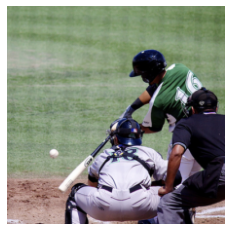

Q: is the person wearing a shirt
A: yes
Model: no


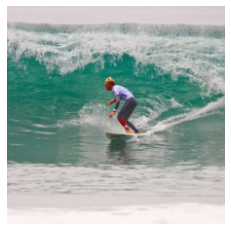

Q: is there traffic on the road
A: no
Model: yes


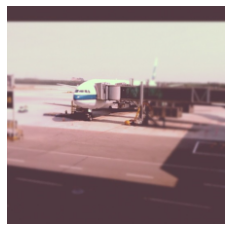

Q: is there a timer pictured
A: no
Model: no


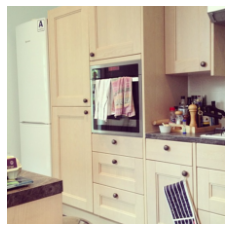

Q: is this an overcast day
A: yes
Model: yes


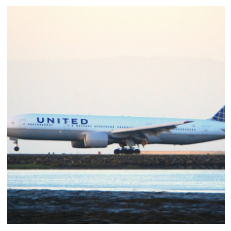

Q: is this image in color
A: yes
Model: no


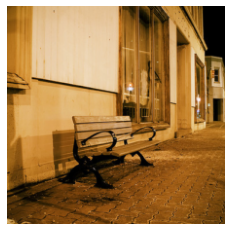

Q: is this their real hair
A: no
Model: yes


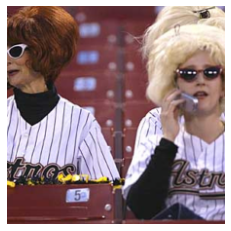

Q: is this a rural area
A: yes
Model: yes


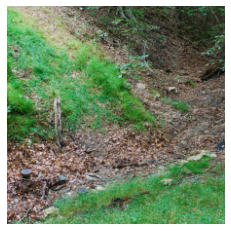

Q: is the bike for sale
A: yes
Model: yes


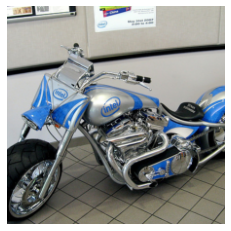

Q: is this a large airport
A: yes
Model: yes


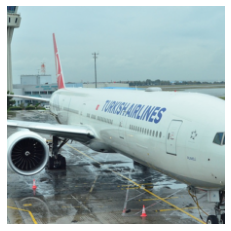

Q: are the parked planes f18s
A: no
Model: no


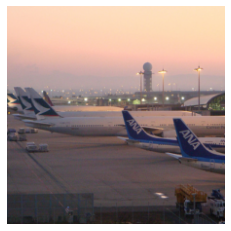

Q: has the sign been altered
A: no
Model: no


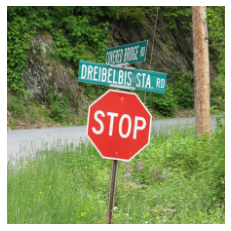

Q: is this a yield sign
A: no
Model: no


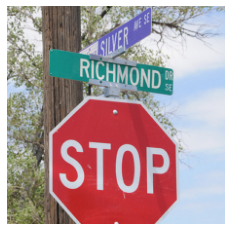

Q: is this room neatly organized
A: no
Model: yes


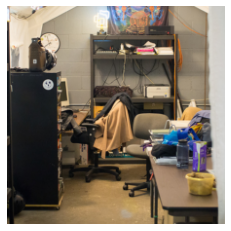

Q: is the man wearing shorts
A: yes
Model: no


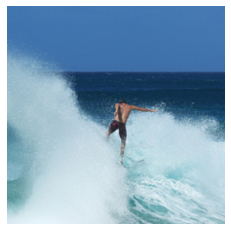

Q: is there an umpire pictured
A: no
Model: yes


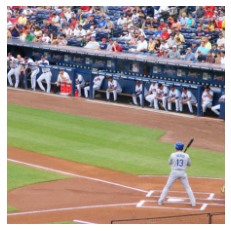

Q: is this a passenger train
A: no
Model: no


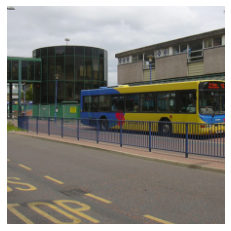

Q: is the desk cluttered
A: yes
Model: no


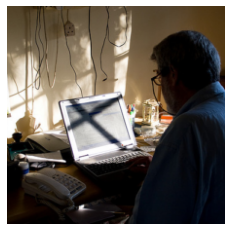

Q: do these sharks float
A: yes
Model: yes


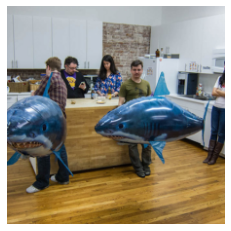

Q: are they eating outside
A: no
Model: no


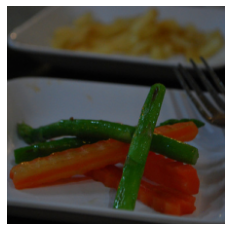

Q: is the shower on
A: no
Model: no


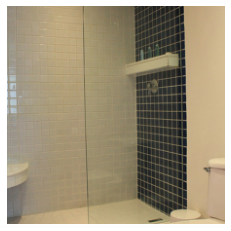

Q: are these animals alive
A: yes
Model: yes


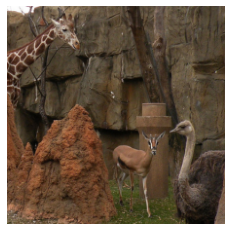

Q: is that a train
A: no
Model: no


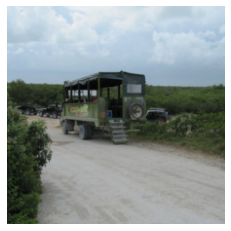

Q: are these love birds
A: no
Model: no


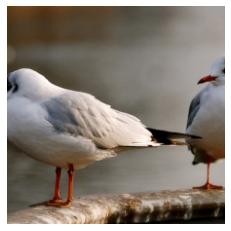

Q: is the bear swimming
A: no
Model: no


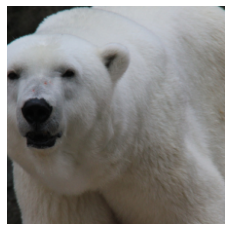

Q: is the monitor on
A: yes
Model: no


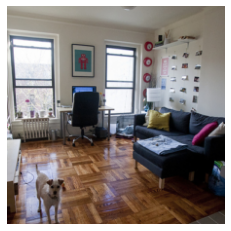

Q: can you see grass
A: no
Model: no


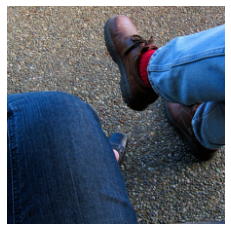

Q: is the stoplight green
A: yes
Model: yes


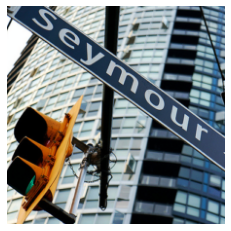

Q: are the bikes on
A: no
Model: no


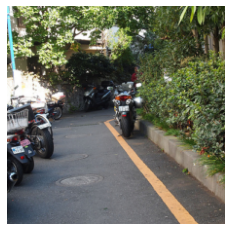

Q: is this zebra real
A: yes
Model: yes


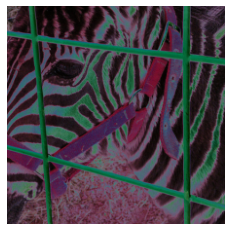

Q: could these be gulls
A: yes
Model: yes


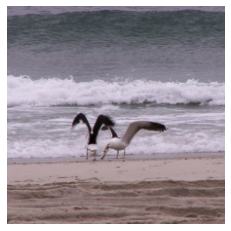

Q: is the banana green
A: yes
Model: yes


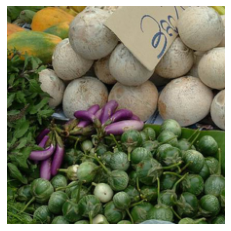

Q: are the blinds up
A: yes
Model: no


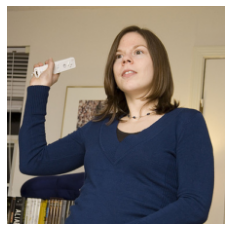

Q: is the giraffe moving
A: no
Model: no


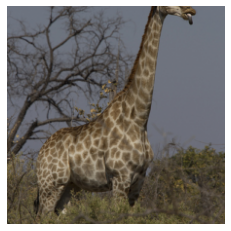

Q: is the cat sleeping
A: yes
Model: no


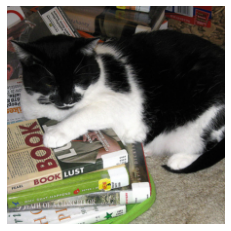

Q: are there any condiments
A: yes
Model: yes


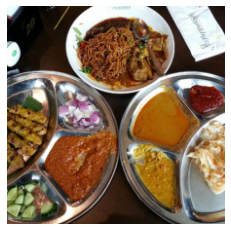

Q: is the carpet patterned
A: yes
Model: yes


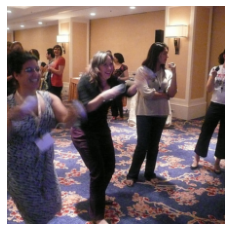

Q: is the clock plain
A: no
Model: no


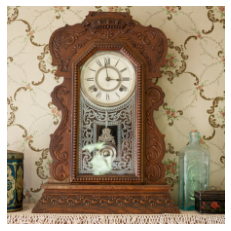

Q: are there surfboards
A: no
Model: yes


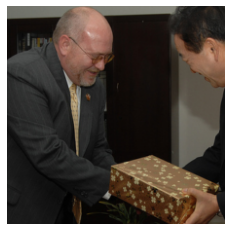

Q: are there umbrellas
A: no
Model: yes


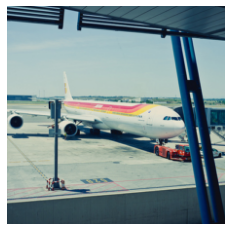

Q: is anyone skiing
A: yes
Model: yes


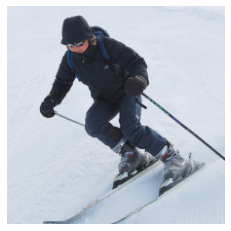

In [14]:
# Plot some samples
images, questions, question_lengths, answers = next(iter(train_loader))
model.eval()
with torch.no_grad():
    outputs = model(images.to(device), questions.to(device), question_lengths)
predictions = torch.argmax(outputs, dim=1).cpu()

questions = questions.transpose(0, 1)
for v, q, a, pred in zip(images, questions, answers, predictions):
    print('Q:', sequence_to_sentence(q))
    print('A:', answer_vocab.itos[a])
    print('Model:', answer_vocab.itos[pred])
    helper.imshow(v)
    plt.show()

## Attention Visualization

Q: would this be a good photo to use as a profile picture if you wanted to conceal your identity
A: no
model: no


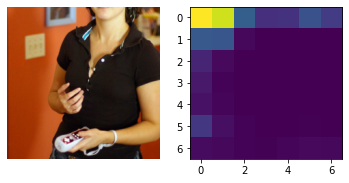

Q: is there a staircase leading up to the train from the road
A: no
model: no


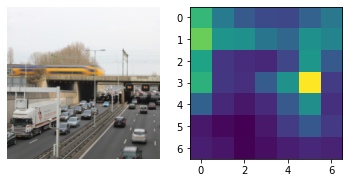

Q: is that a phone number on the yellow post it note
A: yes
model: no


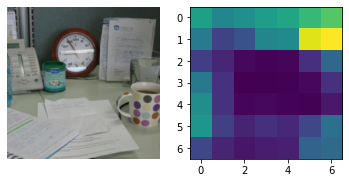

Q: is this giraffe being held in by a wire mesh fence
A: no
model: no


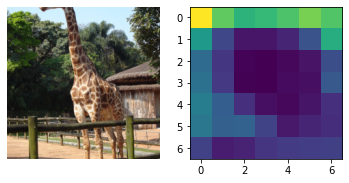

Q: are all three of these players on the same team
A: no
model: no


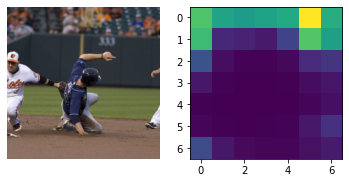

Q: is the elephant drinking from a water source right now
A: no
model: no


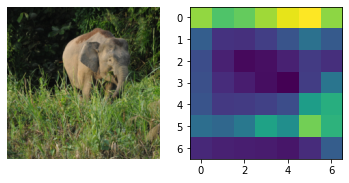

Q: is there a picture of a man on the window
A: yes
model: yes


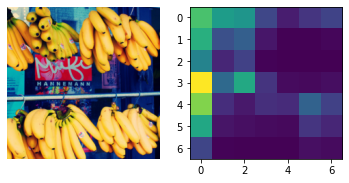

Q: do you see a spoon on the table
A: yes
model: yes


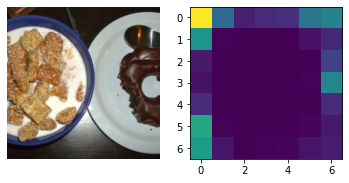

Q: is the expression on the mans face surprise
A: no
model: no


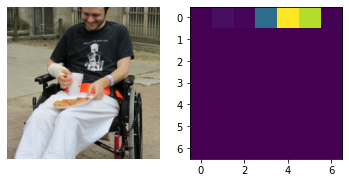

Q: does she have a basket on her bike
A: yes
model: no


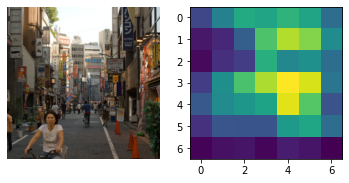

Q: do the elephants appear to be peaceful
A: yes
model: yes


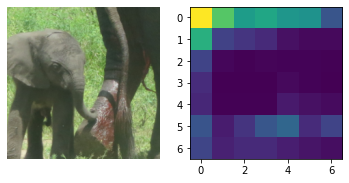

Q: are there green veggies on the plate
A: yes
model: yes


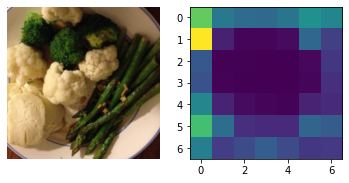

Q: is this a family having a party
A: no
model: yes


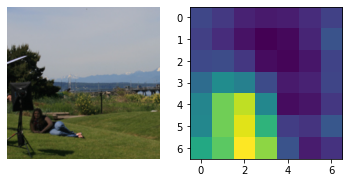

Q: does this water have salt in it
A: yes
model: yes


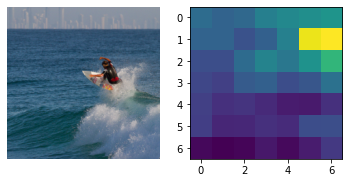

Q: are there any people on the beach
A: no
model: no


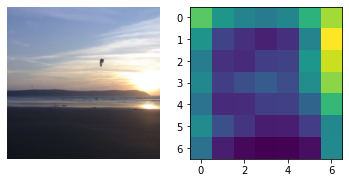

Q: is the man sad at the dog
A: no
model: no


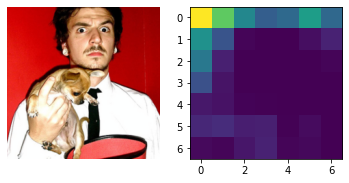

Q: is he going to swing the bat
A: no
model: no


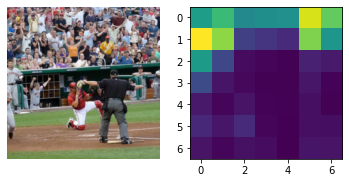

Q: is there a bike in the picture
A: no
model: no


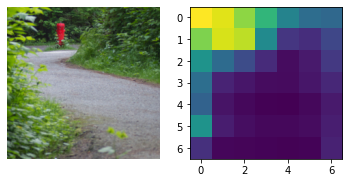

Q: are the edges of the sign peeling
A: no
model: no


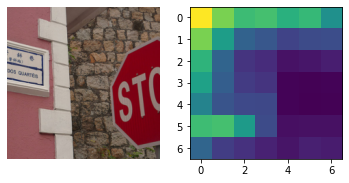

Q: is the woman wearing a suit
A: no
model: yes


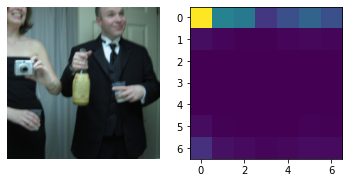

Q: is the batter wearing a helmet
A: no
model: no


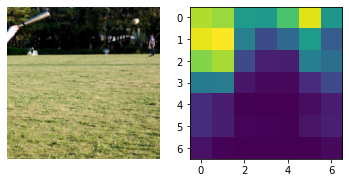

Q: is the woman prepared for play
A: yes
model: yes


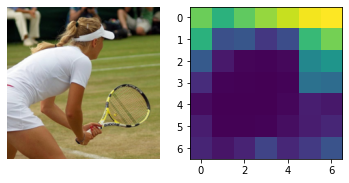

Q: is that lettuce on the plate
A: yes
model: yes


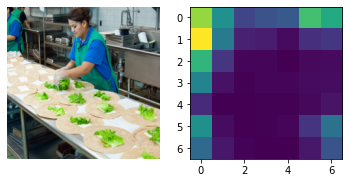

Q: is the train at the station
A: no
model: no


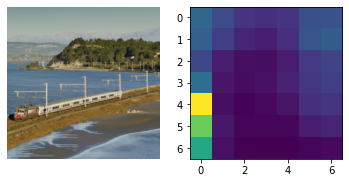

Q: will he hit a home run
A: no
model: no


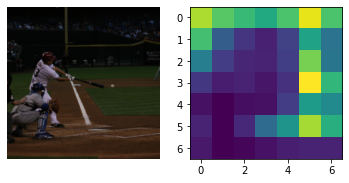

Q: will anyone be using this keyboard
A: yes
model: yes


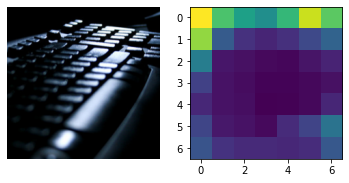

Q: could this be a snoopy cake
A: no
model: no


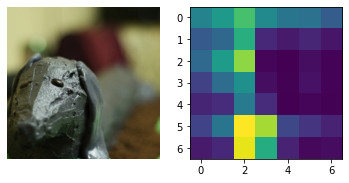

Q: are both men wearing pinstripe suits
A: no
model: no


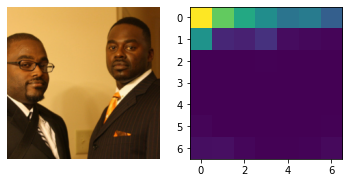

Q: is there bananas in the photo
A: yes
model: no


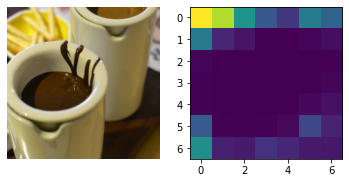

Q: is this an edited photo
A: yes
model: yes


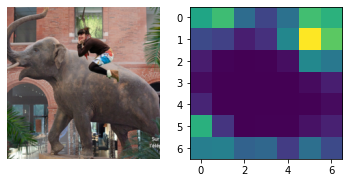

Q: is the cat wet yet
A: no
model: no


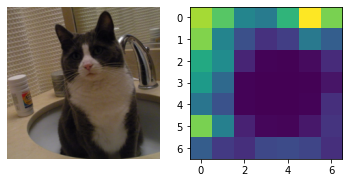

Q: is this picture taken outside
A: no
model: no


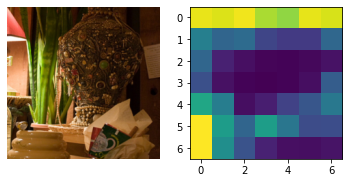

Q: is the person in motion
A: no
model: yes


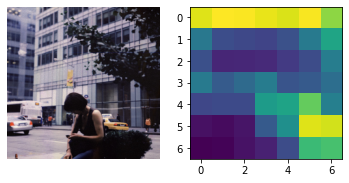

Q: does this animal eat meat
A: no
model: no


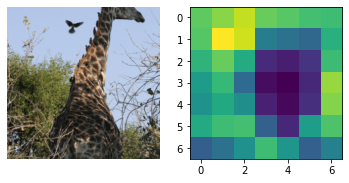

Q: is the player wearing sneakers
A: yes
model: yes


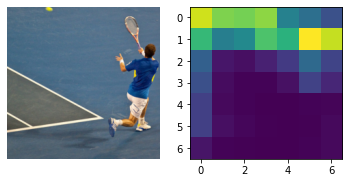

Q: is the street light red
A: yes
model: yes


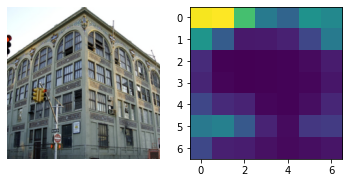

Q: is he in a forest
A: yes
model: yes


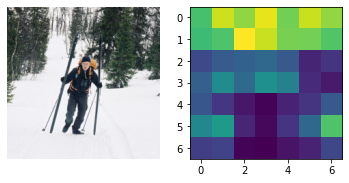

Q: is this a tennis court
A: yes
model: yes


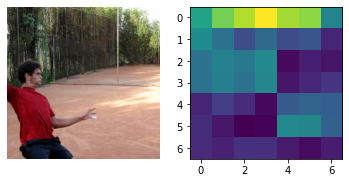

Q: is the elephants eye open
A: yes
model: yes


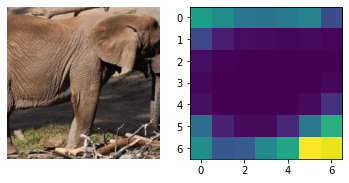

Q: is the microwave plugged in
A: yes
model: yes


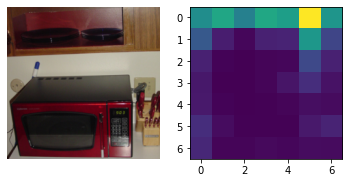

Q: is this a pasta dish
A: yes
model: yes


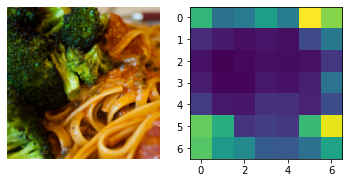

Q: is this a country setting
A: no
model: no


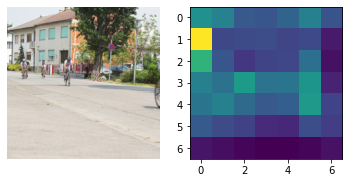

Q: would this be a farmhouse
A: no
model: no


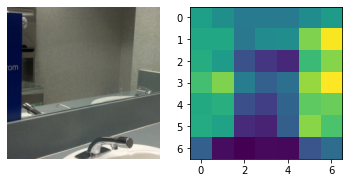

Q: is this an old phone
A: yes
model: yes


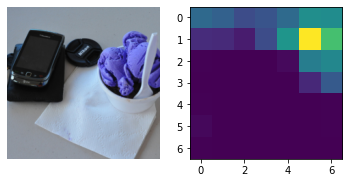

Q: are the units occupied
A: no
model: no


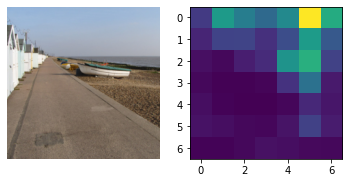

Q: is this picture colorful
A: yes
model: yes


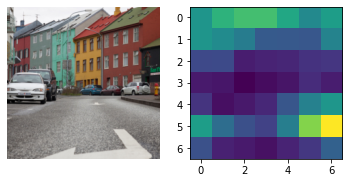

Q: is this a park
A: yes
model: yes


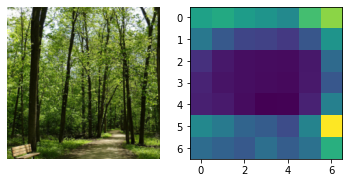

Q: are the lights on
A: yes
model: yes


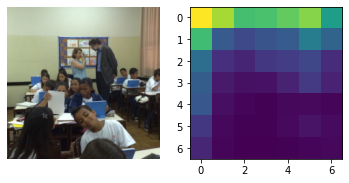

Q: is this a kitchen
A: no
model: no


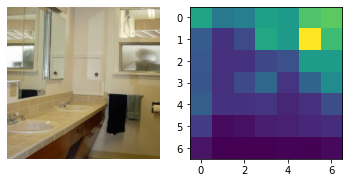

Q: is it night time
A: yes
model: yes


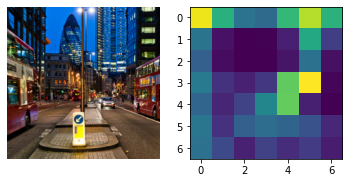

Q: is the kitchen messy
A: yes
model: yes


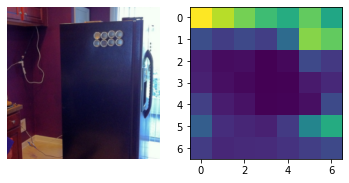

Q: is the room clean
A: yes
model: no


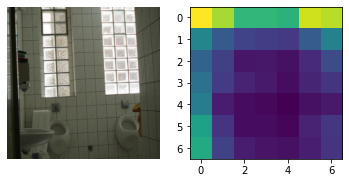

Q: is this a vehicle
A: yes
model: yes


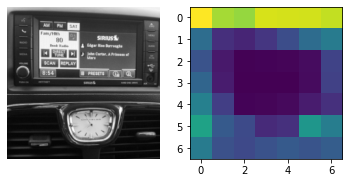

Q: is the park nice
A: yes
model: yes


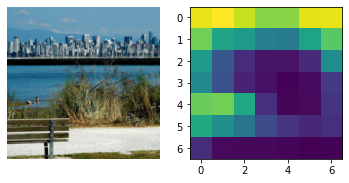

Q: is the sky cloudy
A: yes
model: yes


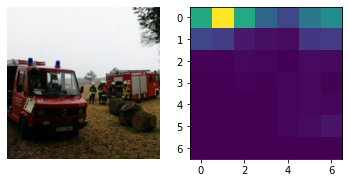

Q: is the runner safe
A: yes
model: yes


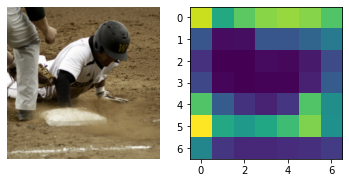

Q: is that a backdrop
A: yes
model: yes


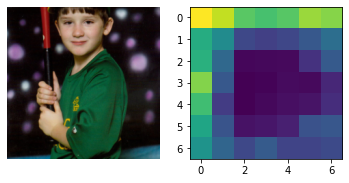

Q: is this at home
A: yes
model: yes


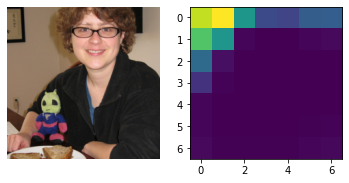

Q: they are white
A: yes
model: no


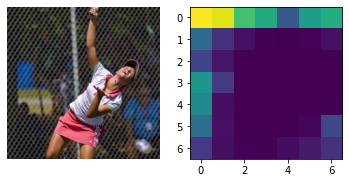

Q: is it nighttime
A: no
model: no


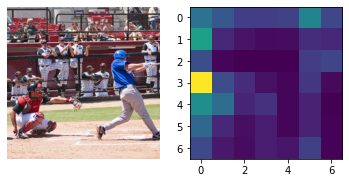

Q: is this dinner
A: yes
model: yes


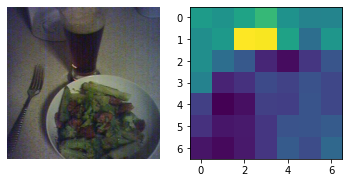

Q: is this lego
A: yes
model: no


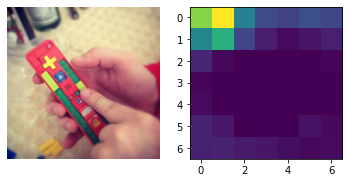

Q: is it windy
A: yes
model: yes


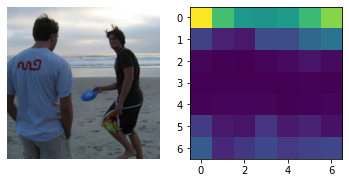

Q: is it raining
A: no
model: no


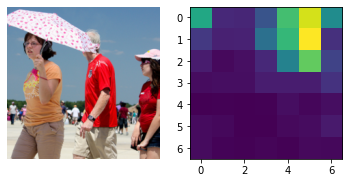

In [15]:
def visualize_attention(loader):
    images, questions, question_length, answers = next(iter(loader))
    predictions = model(images.to(device), questions.to(device), question_length).detach().cpu()
    attenions = model.last_attention.detach().cpu()
    questions = questions.transpose(0, 1)

    for _, v, q, a, pred, atten in zip(range(64), images, questions, answers, predictions, attenions):
        print('Q:', sequence_to_sentence(q))
        print('A:', answer_vocab.itos[a])
        print('model:', answer_vocab.itos[pred.argmax(0)])
        fig = plt.figure()
        ax1 = fig.add_subplot(121)
        ax2 = fig.add_subplot(122)
        helper.imshow(v, ax1)
        ax2.imshow(atten.squeeze(0))
        plt.show()

visualize_attention(train_loader)